# Library

In [1]:
import pandas as pd 
import os

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import glob
import matplotlib.pyplot as plt
import imagehash
import psutil

from PIL import Image
from joblib import Parallel, delayed

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from IPython import display
import time

%matplotlib inline

plt.style.use('ggplot')
pd.set_option('display.max_columns', 300)
pd.set_option('display.max_rows', 100)

---
# <font color=dimgray> Load CSV </font>

In [2]:
train = pd.read_csv("../input/train.csv")

In [3]:
train['path'] = train['id_code'].apply(lambda x: "../input/train_images/"+str(x)+".png")
train.head()

,id_code,diagnosis,path
0,000c1434d8d7,2,../input/train_images/000c1434d8d7.png
1,001639a390f0,4,../input/train_images/001639a390f0.png
2,0024cdab0c1e,1,../input/train_images/0024cdab0c1e.png
3,002c21358ce6,0,../input/train_images/002c21358ce6.png
4,005b95c28852,0,../input/train_images/005b95c28852.png


---
# <font color=dimgray> Get Info of train images </font>

Getting the path of the Image

In [4]:
df = train[['diagnosis', 'path']]
#df['path'] = glob.glob('../input/train_images/*.png')
df.head()

,diagnosis,path
0,2,../input/train_images/000c1434d8d7.png
1,4,../input/train_images/001639a390f0.png
2,1,../input/train_images/0024cdab0c1e.png
3,0,../input/train_images/002c21358ce6.png
4,0,../input/train_images/005b95c28852.png


Calculating the Hash, Shape, Mode, Length and Ratio of each image

In [5]:
def getImageMetaData(file_path):
    with Image.open(file_path) as img:
        img_hash = imagehash.phash(img)
        return img.size, img.mode, str(img_hash), file_path

    
img_meta_l = Parallel(n_jobs=psutil.cpu_count(), verbose=1)(
    (delayed(getImageMetaData)(fp) for fp in glob.glob('../input/train_images/*.png'))
)
img_meta_df = pd.DataFrame(np.array(img_meta_l))
img_meta_df.columns = ['Size', 'Mode', 'Hash', 'path']

[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 442 tasks      | elapsed:   28.9s
[Parallel(n_jobs=4)]: Done 792 tasks      | elapsed:   46.2s
[Parallel(n_jobs=4)]: Done 1653 tasks      | elapsed:  1.5min
[Parallel(n_jobs=4)]: Done 2753 tasks      | elapsed:  2.5min
[Parallel(n_jobs=4)]: Done 3655 out of 3662 | elapsed:  3.2min remaining:    0.4s
[Parallel(n_jobs=4)]: Done 3662 out of 3662 | elapsed:  3.2min finished


In [6]:
df = df.merge(img_meta_df, on='path', how='left')
df.head()

,diagnosis,path,Size,Mode,Hash
0,2,../input/train_images/000c1434d8d7.png,"(3216, 2136)",RGB,819117250ed75eaf
1,4,../input/train_images/001639a390f0.png,"(3216, 2136)",RGB,85815fa57ea51a69
2,1,../input/train_images/0024cdab0c1e.png,"(2416, 1736)",RGB,91c8572d5aad0f27
3,0,../input/train_images/002c21358ce6.png,"(1050, 1050)",RGB,c5981e676b9a384e
4,0,../input/train_images/005b95c28852.png,"(2048, 1536)",RGB,c76538cf65983463


In [7]:
df.to_csv('./image_info.csv', index=False)

In [8]:
df_gb = df.groupby('Hash').count().reset_index()
df_gb.head()

,Hash,diagnosis,path,Size,Mode
0,800d07f01f1f7fe4,1,1,1,1
1,803d453317cd4fb3,1,1,1,1
2,803f15f4709e1ff0,1,1,1,1
3,803f1fe2609f1ee1,1,1,1,1
4,803f4df272cc1f32,1,1,1,1


In [9]:
df_gb_dup = df_gb.query('path > 1')
df_gb_dup

,Hash,diagnosis,path,Size,Mode
20,808d0f3513f33f2d,2,2,2,2
21,808d17355ee51fa5,2,2,2,2
24,808d17715f871ff0,2,2,2,2
41,809d1575571f1ee1,2,2,2,2
55,80ad17e10fb51f17,2,2,2,2
61,80c1173d1fe5cbc9,2,2,2,2
64,80c4170f5ff05e1f,2,2,2,2
66,80c5071f5ee0733f,2,2,2,2
100,8181171d1fe15f9d,2,2,2,2
119,818517b557a51eb5,2,2,2,2


In [10]:
df_gb_dup['path'].value_counts()

2    134
3      7
4      2
Name: path, dtype: int64

In [11]:
dup_hash_l = df_gb_dup['Hash'].values

In [12]:
df_dup = df.loc[df['Hash'].isin(dup_hash_l)].sort_values('Hash')
df_dup.to_csv('./duplicated_info.csv')
df_dup.head(10)

,diagnosis,path,Size,Mode,Hash
297,2,../input/train_images/1632c4311fc9.png,"(2416, 1736)",RGB,808d0f3513f33f2d
2388,1,../input/train_images/a75bab2463d4.png,"(2416, 1736)",RGB,808d0f3513f33f2d
1428,1,../input/train_images/64678182d8a8.png,"(2416, 1736)",RGB,808d17355ee51fa5
1515,1,../input/train_images/6b00cb764237.png,"(2416, 1736)",RGB,808d17355ee51fa5
1847,1,../input/train_images/8273fdb4405e.png,"(2416, 1736)",RGB,808d17715f871ff0
3453,4,../input/train_images/f0098e9d4aee.png,"(2416, 1736)",RGB,808d17715f871ff0
3099,1,../input/train_images/d801c0a66738.png,"(2416, 1736)",RGB,809d1575571f1ee1
1488,1,../input/train_images/68332fdcaa70.png,"(2416, 1736)",RGB,809d1575571f1ee1
2698,4,../input/train_images/ba735b286d62.png,"(2416, 1736)",RGB,80ad17e10fb51f17
3414,4,../input/train_images/ed3a0fc5b546.png,"(2416, 1736)",RGB,80ad17e10fb51f17


### Check All 143 duplication patterns

In [13]:
lst = df_dup.groupby('Hash').count().index
print(len(lst))
print(lst[:5])

143
Index(['808d0f3513f33f2d', '808d17355ee51fa5', '808d17715f871ff0',
       '809d1575571f1ee1', '80ad17e10fb51f17'],
      dtype='object', name='Hash')


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


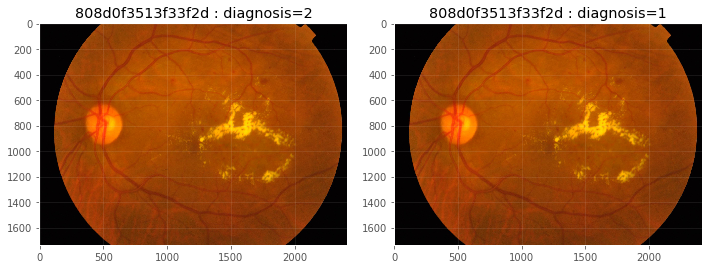

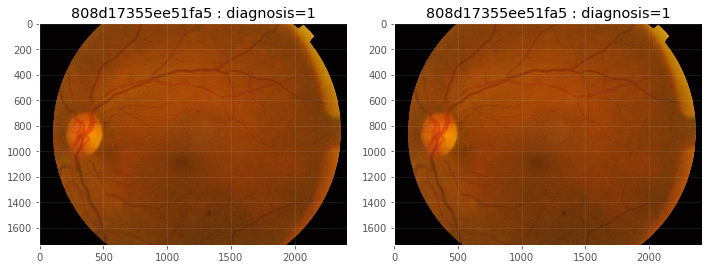

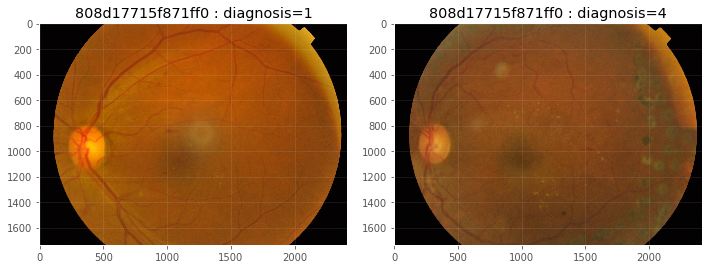

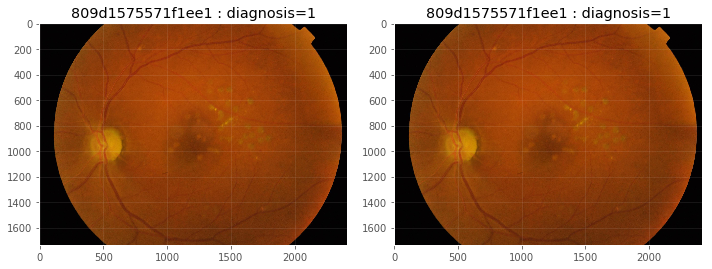

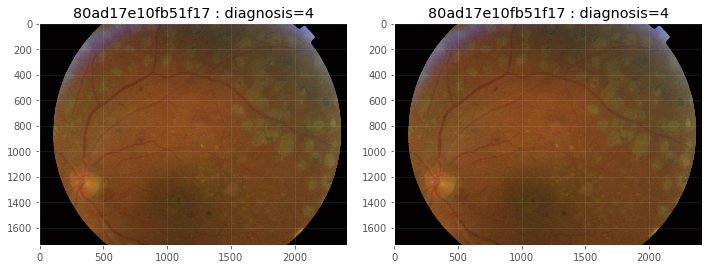

...

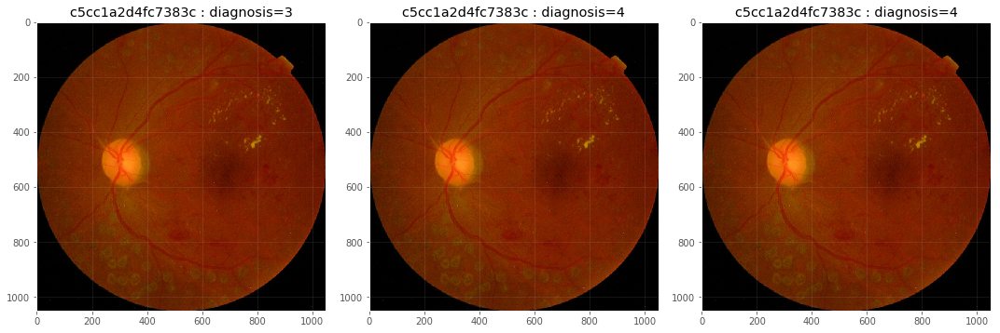

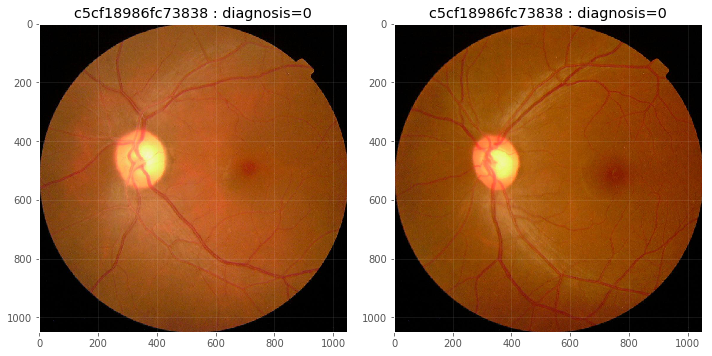

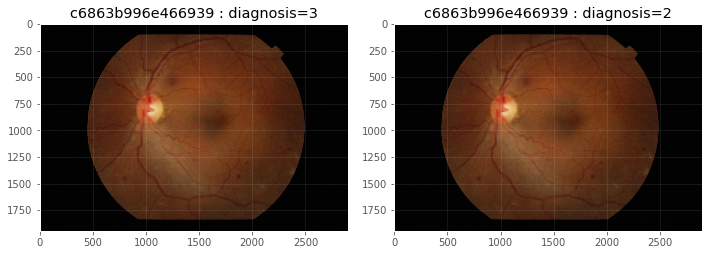

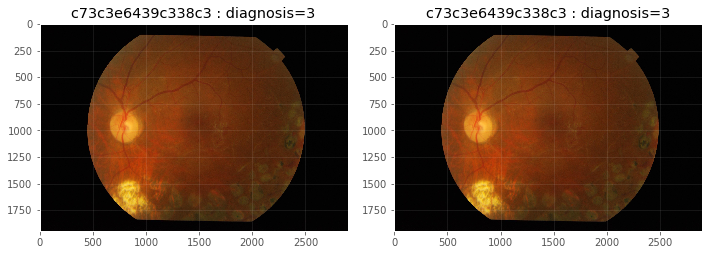

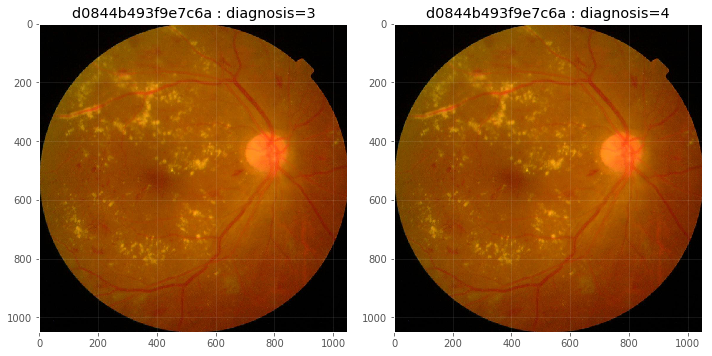

In [14]:
for j, l in enumerate(lst):
    dups = df_dup[df_dup.Hash==l]['path'].values
    diag = df_dup[df_dup.Hash==l]['diagnosis'].values

    fig, ax = plt.subplots(1, len(dups), figsize=(5 * len(dups), 7))
    for i, d in enumerate(dups):
        ax[i].imshow(mpimg.imread(d))
        ax[i].grid(alpha=0.1)
        ax[i].set_title("{} : diagnosis={}".format(l, diag[i]))
    fig.tight_layout();